In [1]:
run_gridsearch = False
skip_best_model_validation = True
skip_best_model_test = True
verbose = False
GPU_SETTING = -1
NUM_ENSEMBLES = 5
BASIN = "hopland"
RES_1H = "mts_hourly"
RES_1D = "mts_daily"
RUN_LABEL = "BASELINE"
MODE = "mts"
READ_STAMP = "20250815T000000Z"

In [2]:
hyperparam_space = {
    "hidden_size": [64, 128, 256],
    "output_dropout": [0.4],
    "seq_length_1D": [90, 120],
    "seq_length_1H": [168, 336],
    "num_layers": [1],
    "epochs": [16, 32, 48],
    "batch_size": [64, 128],
    "schedule_pairs": [
        ((0.5, 0.25), (0.01, 0.005, 0.001))
    ]
}

In [3]:
import sys
import pandas as pd
import os
import itertools
from pathlib import Path
from tqdm import tqdm
import warnings
from datetime import datetime
warnings.simplefilter(action='ignore', category=FutureWarning)

In [4]:
current_dir = os.getcwd()
print(current_dir)

/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/hopland


In [5]:
library_path = os.path.join('..', '..', '..','..','UCB-USACE-RR-PROJECT')
sys.path.insert(0, library_path)
print(sys.path)

['../../../../UCB-USACE-LSTMs', '/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/hopland', '/Users/canruso/Desktop', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python310.zip', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10/lib-dynload', '', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10/site-packages', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10/site-packages/setuptools/_vendor']


In [6]:
from neuralhydrology.evaluation.metrics import *
from UCB_training.UCB_train import UCB_trainer
from UCB_training.UCB_utils import (fractional_multi_lr, write_paths, to_path_or_list, ensure_output_tree, set_active_context, data_dir, repo_root, get_output_dir, make_run_stamp, get_yaml_path, ctx_for, hparams_exists, save_hparams, load_hparams, runs_latest_path, archive_runs_json, read_csv_artifact, ensure_shared_tree)
from UCB_training.UCB_plotting import (plot_timeseries_comparison, scatter_triptych_pngs_v3, ts_triptych_v3)

In [7]:
current_path = os.getcwd()
library_path = current_path.split('UCB-USACE-RR-PROJECT')[0] + 'UCB-USACE-RR-PROJECT'

In [8]:
RUNS_FILE = str(runs_latest_path(BASIN, MODE, RUN_LABEL))
SHOULD_STAMP = not (skip_best_model_validation and skip_best_model_test)
RUN_STAMP = make_run_stamp() if SHOULD_STAMP else None
ACTIVE_STAMP = RUN_STAMP if RUN_STAMP is not None else READ_STAMP

In [9]:
switch_ctx = ctx_for(BASIN, run_stamp=ACTIVE_STAMP, run_label=RUN_LABEL, append_stamp_to_filenames=False)
_SHARED = ensure_shared_tree(BASIN, MODE)
RUNS_PARENT = _SHARED / "runs" / (f"{RUN_LABEL}_{RUN_STAMP}" if RUN_STAMP else RUN_LABEL)

print("NH runs will be written under:")
print(RUNS_PARENT.resolve())

NH runs will be written under:
/Users/canruso/Desktop/UCB-USACE-LSTMs/outputs/hopland/mts_shared/runs/BASELINE


In [10]:
path_to_csv = data_dir()
path_to_yaml = get_yaml_path("hopland_mtslstm2")
path_to_physics_data_1D = path_to_csv / "Hopland_daily_averaged.csv"
path_to_physics_data_1H = path_to_csv  / "Hopland_hourly.csv"

In [11]:
features_with_physics = [
    #from daily.csv
    "RUSSIAN 60 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 60 PRECIP-INC SCREENED",
    "RUSSIAN 70 PRECIP-INC SCREENED",
    "RUSSIAN 70 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "WF RUSSIAN PRECIP-INC SCREENED",
    "WF RUSSIAN ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    #from hopland.csv
    'Hopland Gage FLOW',
    'Russian 60 ET-POTENTIAL',
    'Russian 60 FLOW',
    'Russian 60 FLOW-BASE',
    'Russian 60 INFILTRATION',
    'Russian 60 PERC-SOIL',
    'Russian 60 SATURATION FRACTION',
    'Russian 70 ET-POTENTIAL',
    'Russian 70 FLOW',
    'Russian 70 FLOW-BASE',
    'Russian 70 INFILTRATION',
    'Russian 70 PERC-SOIL',
    'Russian 70 SATURATION FRACTION',
    'WF Russian ET-POTENTIAL',
    'WF Russian FLOW',
    'WF Russian FLOW-BASE',
    'WF Russian INFILTRATION',
    'WF Russian PERC-SOIL',
    'WF Russian SATURATION FRACTION',
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "UKIAH CA FLOW USGS-MERGED",
    #"Lake Mendocino Storage",    
]

In [12]:
no_physics_results = []
physics_results = []

In [13]:
GRID_RANK = "NSE_1H" # NSE_1H or NSE_1D

In [14]:
start_time = datetime.utcnow()
print("Start time:", start_time.strftime("%Y-%m-%d %H:%M:%S"))

Start time: 2025-08-27 09:17:07


In [15]:
hyperparam_names = []
for i, hp in enumerate(hyperparam_space.keys()):
    hyperparam_names.append(hp)

total_iters = 1
for name in hyperparam_names:
    total_iters *= len(hyperparam_space[name])

if run_gridsearch or not hparams_exists(BASIN, MODE, RUN_LABEL):
    for combinations in tqdm(
        itertools.product(*[hyperparam_space[hp] for hp in hyperparam_names]), 
        desc="Grid-Search", 
        total=total_iters, 
        unit="it", 
        ncols=60, 
        ascii=True):

        hp_run = {}
        j = 0
        schedule_pairs = None

        while j < len(hyperparam_names):
            name = hyperparam_names[j]
            val  = combinations[j]

            if name in ("seq_length_1D", "seq_length_1H"):
                hp_run["seq_length"] = {"1D": combinations[j], "1H": combinations[j + 1]}
                j += 2
                continue

            if name == "schedule_pairs":
                schedule_pairs = val
                j += 1
                continue

            hp_run[name] = val
            j += 1

        if schedule_pairs is not None:
            fractions, rates = schedule_pairs
            hp_run["learning_rate"] = fractional_multi_lr(
                epochs=int(hp_run["epochs"]), fractions=list(fractions), lrs=list(rates))
        else:
            hp_run.setdefault("learning_rate", {0: 0.01, 30: 0.005, 40: 0.001})

        if verbose:
            print(f"\nNoPhysics: {hp_run}")
            
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp_run,
            input_features=None,
            physics_informed=False,
            physics_data_file=None,
            hourly=True,  
            extend_train_period=False,
            gpu=GPU_SETTING,
            is_mts = True,
            verbose=verbose,
            runs_parent=RUNS_PARENT,
            run_label=RUN_LABEL,
            run_stamp=RUN_STAMP)
        
        trainer.train()
        csv_1d, metrics_1d = trainer.results(period="validation", mts_trk="1D")
        csv_1h, metrics_1h = trainer.results(period="validation", mts_trk="1H")
        
        row_data = {}
        j = 0
        schedule_pairs = None
        
        while j < len(hyperparam_names):
            row_data[hyperparam_names[j]] = combinations[j]
            j += 1
        
        row_data["learning_rate"] = str(hp_run["learning_rate"])

        for k, v in metrics_1d.items():
            row_data[f"{k}_1D"] = v
        for k, v in metrics_1h.items():
            row_data[f"{k}_1H"] = v
        
        no_physics_results.append(row_data)

    df_no_physics = pd.DataFrame(no_physics_results)
    df_no_physics.sort_values(by=GRID_RANK, ascending=False, inplace=True)
    df_no_physics.reset_index(drop=True, inplace=True)
else:
    print("Skipping grid search!")

Skipping grid search!


In [16]:
if run_gridsearch or not hparams_exists(BASIN, MODE, RUN_LABEL):
    for combinations in tqdm(
            itertools.product(*[hyperparam_space[hp] for hp in hyperparam_names]),
            desc="Grid-Search",
            total=total_iters,
            unit="it",
            ncols=60,
            ascii=True):

        hp_run = {}
        j = 0
        schedule_pairs = None

        while j < len(hyperparam_names):
            name = hyperparam_names[j]
            val = combinations[j]

            if name in ("seq_length_1D", "seq_length_1H"):
                hp_run["seq_length"] = {"1D": combinations[j], "1H": combinations[j + 1]}
                j += 2
                continue

            if name == "schedule_pairs":
                schedule_pairs = val
                j += 1
                continue

            hp_run[name] = val
            j += 1

        if schedule_pairs is not None:
            fractions, rates = schedule_pairs
            hp_run["learning_rate"] = fractional_multi_lr(
                epochs=int(hp_run["epochs"]), fractions=list(fractions), lrs=list(rates))
        else:
            hp_run.setdefault("learning_rate", {0: 0.01, 30: 0.005, 40: 0.001})

        if verbose:
            print(f"\nPhysics: {hp_run}")

        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp_run,
            input_features=features_with_physics,
            physics_informed=True,
            physics_data_file=path_to_physics_data_1H,
            hourly=True,
            extend_train_period=False,
            gpu=GPU_SETTING,
            is_mts = True,
            verbose=verbose,
            runs_parent=RUNS_PARENT,
            run_label=RUN_LABEL,
            run_stamp=RUN_STAMP)

        trainer.train()
        csv_1d, metrics_1d = trainer.results(period="validation", mts_trk="1D")
        csv_1h, metrics_1h = trainer.results(period="validation", mts_trk="1H")

        row_data = {}
        j = 0
        while j < len(hyperparam_names):
            row_data[hyperparam_names[j]] = combinations[j]
            j += 1

        row_data["learning_rate"] = str(hp_run["learning_rate"])

        for k, v in metrics_1d.items():
            row_data[f"{k}_1D"] = v
        for k, v in metrics_1h.items():
            row_data[f"{k}_1H"] = v

        physics_results.append(row_data)
    df_physics = pd.DataFrame(physics_results)
    df_physics.sort_values(by=GRID_RANK, ascending=False, inplace=True)
    df_physics.reset_index(drop=True, inplace=True)
    best_no_phys = df_no_physics.iloc[0].to_dict()
    best_phys = df_physics.iloc[0].to_dict()
    best_no_phys["model_type"] = "no_physics"
    best_phys["model_type"] = "physics"
    best_params_df = pd.DataFrame([best_no_phys, best_phys])
    save_hparams(best_df=best_params_df, basin=BASIN, mode=MODE, label=RUN_LABEL, run_stamp=RUN_STAMP, df_no=df_no_physics, df_phys=df_physics)
else:
    print("Skipping grid search!")

Skipping grid search!


In [17]:
try:
    best_params_df = load_hparams(BASIN, MODE, RUN_LABEL)
except FileNotFoundError as e:
    raise SystemExit(f"[ERROR] {e}  (Set run_gridsearch=True to generate it.)")

best_no_phys = best_params_df.query("model_type == 'no_physics'").iloc[0].to_dict()
best_phys    = best_params_df.query("model_type == 'physics'").iloc[0].to_dict()

best_no_physics_params = {}
j = 0
while j < len(hyperparam_names):
    name = hyperparam_names[j]

    if name == "output_dropout":
        best_no_physics_params[name] = float(best_no_phys[name])
        j += 1

    elif name in ("seq_length_1D", "seq_length_1H"):

        best_no_physics_params["seq_length"] = {
            "1D": int(best_no_phys["seq_length_1D"]),
            "1H": int(best_no_phys["seq_length_1H"])}
        j += 2

    elif name == "schedule_pairs":
        j += 1

    else:
        best_no_physics_params[name] = int(best_no_phys[name])
        j += 1

if "learning_rate" in best_no_phys and pd.notna(best_no_phys["learning_rate"]):

    best_no_physics_params["learning_rate"] = eval(str(best_no_phys["learning_rate"]))

elif "schedule_pairs" in best_no_phys and pd.notna(best_no_phys["schedule_pairs"]):
    sp = best_no_phys["schedule_pairs"]
    if isinstance(sp, str):
        sp = eval(sp)
    fractions, rates = sp
    best_no_physics_params["learning_rate"] = fractional_multi_lr(
        epochs=int(best_no_physics_params["epochs"]),
        fractions=list(fractions),
        lrs=list(rates))

else:
    best_no_physics_params["learning_rate"] = {0: 0.01, 30: 0.005, 40: 0.001}

best_physics_params = {}
j = 0
while j < len(hyperparam_names):
    name = hyperparam_names[j]

    if name == "output_dropout":
        best_physics_params[name] = float(best_phys[name])
        j += 1

    elif name in ("seq_length_1D", "seq_length_1H"):
        best_physics_params["seq_length"] = {
            "1D": int(best_phys["seq_length_1D"]),
            "1H": int(best_phys["seq_length_1H"])}
        j += 2

    elif name == "schedule_pairs":
        j += 1

    else:
        best_physics_params[name] = int(best_phys[name])
        j += 1

if "learning_rate" in best_phys and pd.notna(best_phys["learning_rate"]):
    best_physics_params["learning_rate"] = eval(str(best_phys["learning_rate"]))

elif "schedule_pairs" in best_phys and pd.notna(best_phys["schedule_pairs"]):
    sp = best_phys["schedule_pairs"]
    if isinstance(sp, str):
        sp = eval(sp)
    fractions, rates = sp
    best_physics_params["learning_rate"] = fractional_multi_lr(
        epochs=int(best_physics_params["epochs"]),
        fractions=list(fractions),
        lrs=list(rates))

else:
    best_physics_params["learning_rate"] = {0: 0.01, 30: 0.005, 40: 0.001}

print("Loaded best hyperparams from CSV:")
print("Best NO-PHYS:", best_no_physics_params)
print("Best PHYS:", best_physics_params)

Loaded best hyperparams from CSV:
Best NO-PHYS: {'hidden_size': 256, 'output_dropout': 0.4, 'seq_length': {'1D': 120, '1H': 336}, 'num_layers': 1, 'epochs': 48, 'batch_size': 64, 'learning_rate': {0: 0.01, 24: 0.005, 36: 0.001}}
Best PHYS: {'hidden_size': 128, 'output_dropout': 0.4, 'seq_length': {'1D': 120, '1H': 336}, 'num_layers': 1, 'epochs': 32, 'batch_size': 64, 'learning_rate': {0: 0.01, 16: 0.005, 24: 0.001}}


In [18]:
if not skip_best_model_validation:
    noPhysValTrainer = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=False,
        gpu=GPU_SETTING,
        is_mts = True,
        # num_ensemble_members=NUM_ENSEMBLES,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    noPhysValTrainer.train()
    noPhys_val_csv_1D, noPhys_val_metrics_1D = noPhysValTrainer.results(period="validation", mts_trk="1D")
    noPhys_val_csv_1H, noPhys_val_metrics_1H = noPhysValTrainer.results(period="validation", mts_trk="1H")
    print("NO-PHYS VAL 1D => NSE =", noPhys_val_metrics_1D.get("NSE", None))
    print("NO-PHYS VAL 1H => NSE =", noPhys_val_metrics_1H.get("NSE", None))

In [19]:
if not skip_best_model_validation:
    physValTrainer = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data_1H,
        hourly=True,
        extend_train_period=False,
        gpu=GPU_SETTING,
        is_mts = True,
        # num_ensemble_members=NUM_ENSEMBLES,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    physValTrainer.train()
    phys_val_csv_1D, phys_val_metrics_1D = physValTrainer.results(period="validation", mts_trk="1D")
    phys_val_csv_1H, phys_val_metrics_1H = physValTrainer.results(period="validation", mts_trk="1H")
    print("PHYS VAL 1D => NSE =", phys_val_metrics_1D.get("NSE", None))
    print("PHYS VAL 1H => NSE =", phys_val_metrics_1H.get("NSE", None))

HMS
  NSE = 0.794
  PBIAS = -5.487
LSTM
  NSE = 0.858
  PBIAS = 1.584
PILSTM
  NSE = 0.878
  PBIAS = 1.740


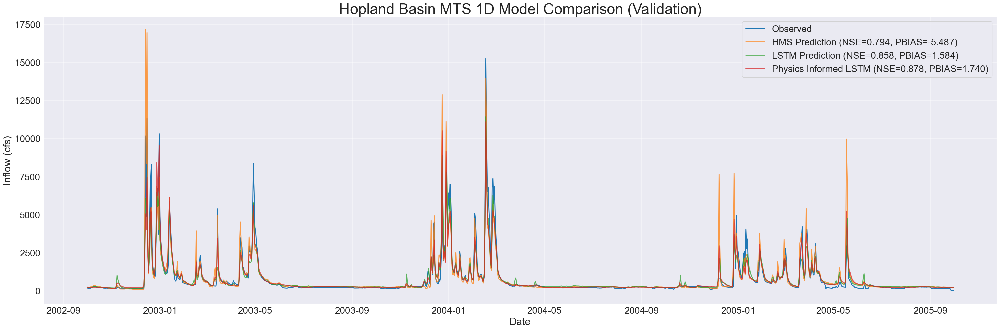

In [20]:
switch_ctx(RES_1D)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1D, phys_val_csv_1D, path_to_physics_data_1D), title="Hopland Basin MTS 1D Model Comparison (Validation)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_val_metrics_1D.csv", ts_out="hopland_mts_val_1D_combined_ts.csv", fig_out="hopland_mts_val_1D_model_comparison.png", legend_font=20, axis_font=22)
else:
    combined_df_val_1D = read_csv_artifact("hopland_mts_val_1D_combined_ts.csv", kind="csv", period="validation", stamp = READ_STAMP, run_label = RUN_LABEL)
    plot_timeseries_comparison(source=combined_df_val_1D, title="Hopland Basin MTS 1D Model Comparison (Validation)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_val_metrics_1D.csv", ts_out="hopland_mts_val_1D_combined_ts.csv", fig_out="hopland_mts_val_1D_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.758
  PBIAS = -5.414
LSTM
  NSE = 0.837
  PBIAS = 1.966
PILSTM
  NSE = 0.863
  PBIAS = 0.498


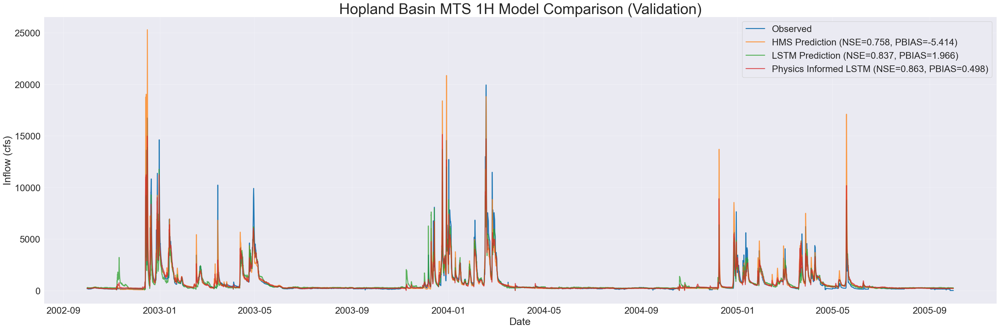

In [21]:
switch_ctx(RES_1H)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1H, phys_val_csv_1H, path_to_physics_data_1H), title="Hopland Basin MTS 1H Model Comparison (Validation)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_val_metrics_1H.csv", ts_out="hopland_mts_val_1H_combined_ts.csv", fig_out="hopland_mts_val_1H_model_comparison.png", legend_font=20, axis_font=22)
else:
    combined_df_val_1H = read_csv_artifact("hopland_mts_val_1H_combined_ts.csv", kind="csv", period="validation", stamp = READ_STAMP, run_label = RUN_LABEL)
    plot_timeseries_comparison(source=combined_df_val_1H, title="Hopland Basin MTS 1H Model Comparison (Validation)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_val_metrics_1H.csv", ts_out="hopland_mts_val_1H_combined_ts.csv", fig_out="hopland_mts_val_1H_model_comparison.png", legend_font=20, axis_font=22)

In [22]:
switch_ctx(RES_1D)

if skip_best_model_validation:
    val_metrics = read_csv_artifact("hopland_mts_val_metrics_1D.csv",  kind="metrics", period="validation", index_col=0, stamp = READ_STAMP, run_label = RUN_LABEL)
    print(val_metrics)

                       HMS           LSTM         PILSTM
NSE               0.794203       0.858460       0.877608
MSE          394832.064406  271551.572789  234816.180275
RMSE            628.356638     521.106105     484.578353
KGE               0.874059       0.772888       0.818600
Alpha-NSE         1.062471       0.781521       0.828352
Beta-KGE          1.054872       0.984158       0.982601
Beta-NSE          0.029892      -0.008630      -0.009478
Pearson-r         0.905409       0.940032       0.943961
FHV               7.260398     -21.283372     -17.244391
FMS              -5.964464      -5.269649       2.810917
FLV              94.259460      97.263154      97.574474
Peak-Timing       0.000000       0.200000       0.000000
Peak-MAPE        24.046090      37.224709      30.301896
PBIAS            -5.487217       1.584249       1.739865


In [23]:
switch_ctx(RES_1H)

if skip_best_model_validation:
    val_metrics = read_csv_artifact("hopland_mts_val_metrics_1H.csv",  kind="metrics", period="validation", index_col=0, stamp = READ_STAMP, run_label = RUN_LABEL)
    print(val_metrics)

                       HMS           LSTM         PILSTM
NSE               0.758403       0.837146       0.862573
MSE          522557.216232  352242.167766  297244.761670
RMSE            722.881191     593.499931     545.201579
KGE               0.859804       0.763779       0.819162
Alpha-NSE         1.066691       0.776056       0.831540
Beta-KGE          1.054137       0.980343       0.995021
Beta-NSE          0.027782      -0.010088      -0.002555
Pearson-r         0.889201       0.927453       0.934434
FHV               5.298288     -24.667787     -20.159855
FMS              -8.691652     -11.223878       1.042344
FLV              94.133933      -3.331344      -2.669891
Peak-Timing            NaN            NaN            NaN
Peak-MAPE        37.068683      36.506002      36.696998
PBIAS            -5.413689       1.965726       0.497860


# Test Period

In [24]:
if not skip_best_model_test:
    print("\nTraining No-Physics MTS model for test period...")
    mtsNoPhysicsTest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=True,
        gpu=GPU_SETTING,
        num_ensemble_members=NUM_ENSEMBLES,
        is_mts = True,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    mtsNoPhysicsTest.train()
    no_physics_test_csv_1D, no_physics_test_metrics_1D = mtsNoPhysicsTest.results(period="test", mts_trk="1D")
    no_physics_test_csv_1H, no_physics_test_metrics_1H = mtsNoPhysicsTest.results(period="test", mts_trk="1H")
    print("\n[No-Physics Test] NSE @1D =", no_physics_test_metrics_1D.get("NSE", None))
    print("[No-Physics Test] NSE @1H =", no_physics_test_metrics_1H.get("NSE", None))

In [25]:
if not skip_best_model_test:
    print("\nTraining Physics MTS model for test period...")
    mtsPhysicsTest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data_1H,
        hourly=True,
        extend_train_period=True,
        gpu=GPU_SETTING,
        num_ensemble_members=NUM_ENSEMBLES,
        is_mts = True,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    mtsPhysicsTest.train()
    physics_test_csv_1D, physics_test_metrics_1D = mtsPhysicsTest.results(period="test", mts_trk="1D")
    physics_test_csv_1H, physics_test_metrics_1H = mtsPhysicsTest.results(period="test", mts_trk="1H")
    print("\n[Physics Test] NSE @1D =", physics_test_metrics_1D.get("NSE", None))
    print("[Physics Test] NSE @1H =", physics_test_metrics_1H.get("NSE", None))

HMS
  NSE = 0.794
  PBIAS = -18.533
LSTM
  NSE = 0.807
  PBIAS = -18.866
PILSTM
  NSE = 0.843
  PBIAS = -11.843


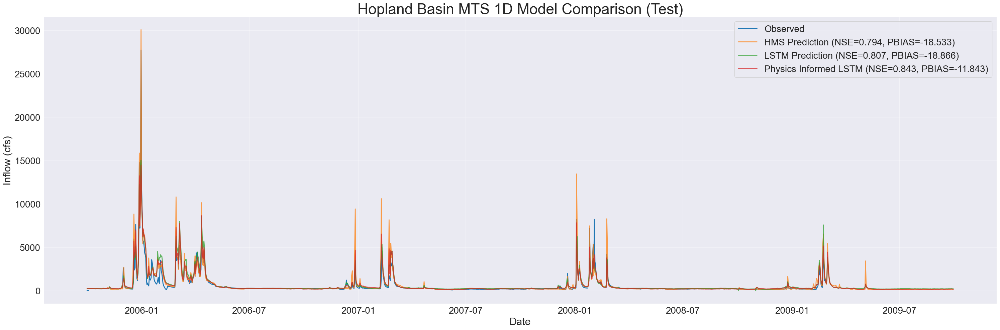

In [26]:
switch_ctx(RES_1D)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Basin MTS 1D Model Comparison (Test)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_1D_combined_ts.csv", fig_out="hopland_mts_test_1D_model_comparison.png", legend_font=20, axis_font=22)
else:
    combined_df_test_1D = read_csv_artifact("hopland_mts_test_1D_combined_ts.csv", kind="csv", period="test", stamp = READ_STAMP, run_label = RUN_LABEL)
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Basin MTS 1D Model Comparison (Test)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_1D_combined_ts.csv", fig_out="hopland_mts_test_1D_model_comparison.png", legend_font=20, axis_font=22)

In [27]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Basin MTS 1D Model Comparison (Test)", backend="plotly", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_1D_combined_ts.csv", fig_out="hopland_mts_test_1D_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Basin MTS 1D Model Comparison (Test)", backend="plotly", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_1D_combined_ts.csv", fig_out="hopland_mts_test_1D_model_omparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.794
  PBIAS = -18.533
LSTM
  NSE = 0.807
  PBIAS = -18.866
PILSTM
  NSE = 0.843
  PBIAS = -11.843


HMS
  NSE = 0.752
  PBIAS = -18.555
LSTM
  NSE = 0.811
  PBIAS = -17.615
PILSTM
  NSE = 0.826
  PBIAS = -11.072


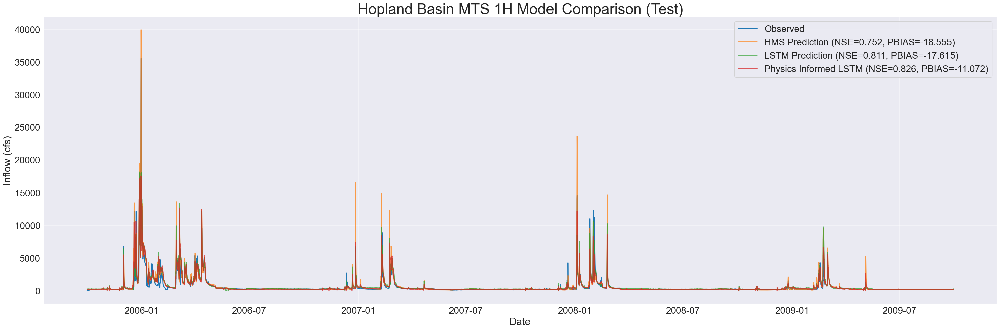

In [28]:
switch_ctx(RES_1H)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), title="Hopland Basin MTS 1H Model Comparison (Test)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1H.csv", ts_out="hopland_mts_test_1H_combined_ts.csv", fig_out="hopland_mts_test_1H_model_comparison.png", legend_font=20, axis_font=22)
else:
    combined_df_test_1H = read_csv_artifact("hopland_mts_test_1H_combined_ts.csv", kind="csv", period="test", stamp = READ_STAMP, run_label = RUN_LABEL)
    plot_timeseries_comparison(source=combined_df_test_1H, title="Hopland Basin MTS 1H Model Comparison (Test)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1H.csv", ts_out="hopland_mts_test_1H_combined_ts.csv", fig_out="hopland_mts_test_1H_model_comparison.png", legend_font=20, axis_font=22)

In [29]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), title="Hopland Basin MTS 1H Model Comparison (Test)", backend="plotly", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1H.csv", ts_out="hopland_mts_test_1H_combined_ts.csv", fig_out="hopland_mts_test_1H_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1H, title="Hopland Basin MTS 1H Model Comparison (Test)", backend="plotly", metrics=["NSE", "PBIAS"], metrics_out="hopland_mts_test_metrics_1H.csv", ts_out="hopland_mts_test_1H_combined_ts.csv", fig_out="hopland_mts_test_1H_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.752
  PBIAS = -18.555
LSTM
  NSE = 0.811
  PBIAS = -17.615
PILSTM
  NSE = 0.826
  PBIAS = -11.072


In [30]:
switch_ctx(RES_1D)

test_metrics = read_csv_artifact("hopland_mts_test_metrics_1D.csv", kind="metrics", period="test", index_col=0, stamp = READ_STAMP, run_label = RUN_LABEL)
print(test_metrics)

                       HMS           LSTM         PILSTM
NSE               0.794497       0.807364       0.842601
MSE          408094.845610  382543.427321  312568.176978
RMSE            638.823016     618.500952     559.077970
KGE               0.727840       0.786718       0.840538
Alpha-NSE         1.186924       0.971542       0.929949
Beta-KGE          1.185327       1.188659       1.118431
Beta-NSE          0.079795       0.081230       0.050992
Pearson-r         0.930832       0.904673       0.919409
FHV              23.955100      -1.081270      -2.362704
FMS              31.744872      27.294590      34.760962
FLV              96.362760      -2.094279      97.910088
Peak-Timing       0.200000       0.000000       0.200000
Peak-MAPE        37.534168      49.257676      35.213615
PBIAS           -18.532697     -18.865894     -11.843070


In [31]:
switch_ctx(RES_1H)

test_metrics = read_csv_artifact("hopland_mts_test_metrics_1H.csv", kind="metrics", period="test", index_col=0, stamp = READ_STAMP, run_label = RUN_LABEL)
print(test_metrics)

                       HMS           LSTM         PILSTM
NSE               0.751830       0.810602       0.826479
MSE          549210.378443  419144.760379  384009.027426
RMSE            741.087295     647.413902     619.684619
KGE               0.711821       0.788027       0.842440
Alpha-NSE         1.204128       0.932047       0.932503
Beta-KGE          1.185550       1.176154       1.110718
Beta-NSE          0.075689       0.071856       0.045164
Pearson-r         0.916631       0.903644       0.910496
FHV              22.679614      -4.053460      -5.292324
FMS              26.515350       7.680625      38.794783
FLV              96.357821      -1.801937      -1.311938
Peak-Timing            NaN            NaN            NaN
Peak-MAPE        40.299279      28.739120      28.455909
PBIAS           -18.555029     -17.615424     -11.071789


In [32]:
if not skip_best_model_test:
    write_paths("no_physics", mtsNoPhysicsTest, filename = RUNS_FILE)
    write_paths("physics", mtsPhysicsTest, filename = RUNS_FILE)
    archived_path = archive_runs_json(Path(RUNS_FILE), BASIN, MODE, RUN_LABEL, RUN_STAMP)

In [33]:
end_time = datetime.utcnow()
print("End time:", end_time.strftime("%Y-%m-%d %H:%M:%S"))
print("Total time:", end_time - start_time)

End time: 2025-08-27 09:17:35
Total time: 0:00:28.191851


##### Additional Plots

In [34]:
if skip_best_model_validation:
    switch_ctx(RES_1D)
    combined_df_daily_val = read_csv_artifact("hopland_mts_val_1D_combined_ts.csv", kind="csv", period="validation", stamp = READ_STAMP, run_label = RUN_LABEL)
    switch_ctx(RES_1H)
    combined_df_hourly_val = read_csv_artifact("hopland_mts_val_1H_combined_ts.csv", kind="csv", period="validation", stamp = READ_STAMP, run_label = RUN_LABEL)

if skip_best_model_test:
    switch_ctx(RES_1D)
    combined_df_daily = read_csv_artifact("hopland_mts_test_1D_combined_ts.csv", kind="csv", period="test", stamp = READ_STAMP, run_label = RUN_LABEL)
    switch_ctx(RES_1H)
    combined_df_hourly = read_csv_artifact("hopland_mts_test_1H_combined_ts.csv", kind="csv", period="test", stamp = READ_STAMP, run_label = RUN_LABEL)

In [35]:
metric_list = ["NSE", "PBIAS"]

wettest_start_val = "2003-10-01"
wettest_end_val = "2004-09-30"
dryest_start_val = "2004-10-01"
dryest_end_val = "2005-09-30"
wettest_start_test = "2005-10-01"
wettest_end_test = "2006-09-30"
dryest_start_test = "2008-10-01"
dryest_end_test = "2009-09-30"

HMS
  NSE = 0.794
  PBIAS = -5.487
LSTM
  NSE = 0.858
  PBIAS = 1.584
PILSTM
  NSE = 0.878
  PBIAS = 1.740


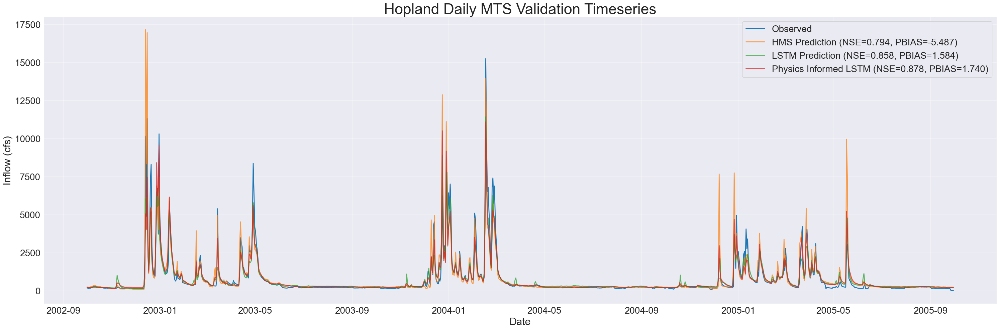

In [36]:
switch_ctx(RES_1D)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1D, phys_val_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Validation Timeseries", backend="mpl", metrics=metric_list, metrics_out="hopland_mts_val_metrics_1D.csv", ts_out="hopland_mts_val_1D_combined_ts.csv", fig_out="hopland_mts_val_1D_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_daily_val, title="Hopland Daily MTS Validation Timeseries", backend="mpl", metrics=metric_list, metrics_out="hopland_mts_val_metrics_1D.csv", ts_out="hopland_mts_val_1D_combined_ts.csv", fig_out="hopland_mts_val_1D_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.758
  PBIAS = -5.414
LSTM
  NSE = 0.837
  PBIAS = 1.966
PILSTM
  NSE = 0.863
  PBIAS = 0.498


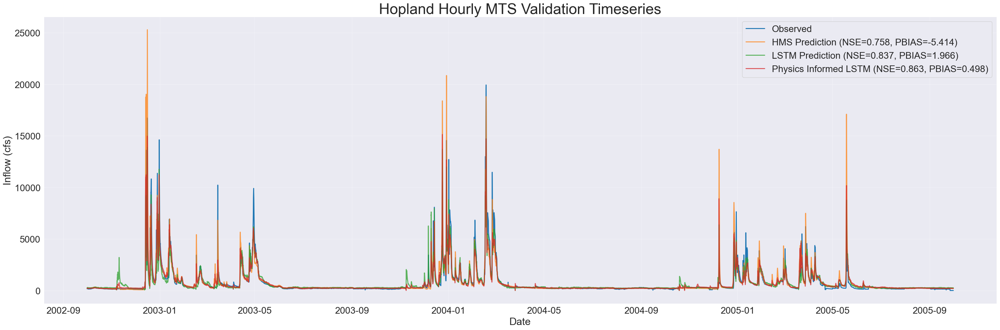

In [37]:
switch_ctx(RES_1H)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1H, phys_val_csv_1H, path_to_physics_data_1H), title="Hopland Hourly MTS Validation Timeseries", backend="mpl", metrics=metric_list, metrics_out="hopland_mts_val_metrics_1H.csv", ts_out="hopland_mts_val_1H_combined_ts.csv", fig_out="hopland_mts_val_1H_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_hourly_val, title="Hopland Hourly MTS Validation Timeseries", backend="mpl", metrics=metric_list, metrics_out="hopland_mts_val_metrics_1H.csv", ts_out="hopland_mts_val_1H_combined_ts.csv", fig_out="hopland_mts_val_1H_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.794
  PBIAS = -18.533
LSTM
  NSE = 0.807
  PBIAS = -18.866
PILSTM
  NSE = 0.843
  PBIAS = -11.843


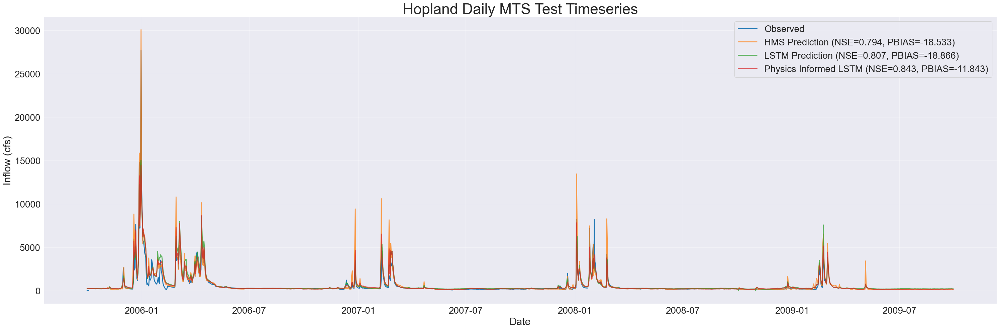

In [38]:
switch_ctx(RES_1D)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Test Timeseries", backend="mpl", metrics=metric_list, metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_ts_1D.csv", fig_out="hopland_mts_test_plot_1D.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Daily MTS Test Timeseries", backend="mpl", metrics=metric_list, metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_1D_combined_ts.csv", fig_out="hopland_mts_test_1D_model_comparison.png", legend_font=20, axis_font=22)

In [39]:
switch_ctx(RES_1H)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Test Timeseries - Interactive", backend="plotly", metrics=metric_list, metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_1D_combined_ts.csv", fig_out="hopland_mts_test_1D_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Daily MTS Test Timeseries - Interactive", backend="plotly", metrics=metric_list, metrics_out="hopland_mts_test_metrics_1D.csv", ts_out="hopland_mts_test_1D_combined_ts.csv", fig_out="hopland_mts_test_1D_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.794
  PBIAS = -18.533
LSTM
  NSE = 0.807
  PBIAS = -18.866
PILSTM
  NSE = 0.843
  PBIAS = -11.843


##### Wettest Year Performance

HMS
  NSE = 0.862
  PBIAS = 5.061
LSTM
  NSE = 0.890
  PBIAS = 3.760
PILSTM
  NSE = 0.885
  PBIAS = 9.722


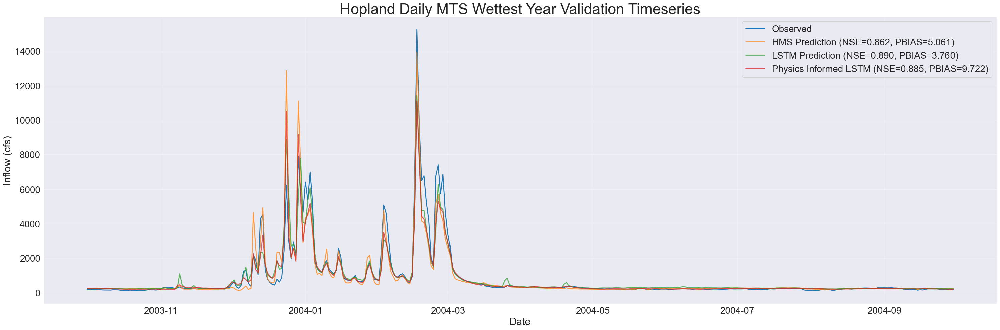

In [40]:
switch_ctx(RES_1D)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1D, phys_val_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Wettest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_val, end_date=wettest_end_val, metrics_out="hopland_mts_wet_val_metrics_1D.csv", ts_out="hopland_mts_wet_val_1D_combined_ts.csv", fig_out="hopland_mts_wet_val_1D_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_daily_val, title="Hopland Daily MTS Wettest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_val, end_date=wettest_end_val, metrics_out="hopland_mts_wet_val_metrics_1D.csv", ts_out="hopland_mts_wet_val_1D_combined_ts.csv", fig_out="hopland_mts_wet_val_1D_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.821
  PBIAS = 5.082
LSTM
  NSE = 0.862
  PBIAS = 2.326
PILSTM
  NSE = 0.863
  PBIAS = 10.024


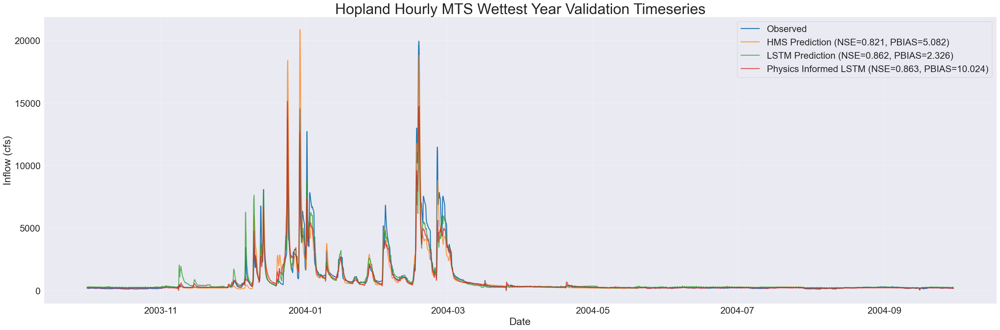

In [41]:
switch_ctx(RES_1H)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1H, phys_val_csv_1H, path_to_physics_data_1H), title="Hopland Hourly MTS Wettest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_val, end_date=wettest_end_val, metrics_out="hopland_mts_wet_val_metrics_1H.csv", ts_out="hopland_mts_wet_val_1H_combined_ts.csv", fig_out="hopland_mts_wet_val_1H_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_hourly_val, title="Hopland Hourly MTS Wettest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_val, end_date=wettest_end_val, metrics_out="hopland_mts_wet_val_metrics_1H.csv", ts_out="hopland_mts_wet_val_1H_combined_ts.csv", fig_out="hopland_mts_wet_val_1H_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.898
  PBIAS = -16.645
LSTM
  NSE = 0.803
  PBIAS = -20.184
PILSTM
  NSE = 0.836
  PBIAS = -12.640


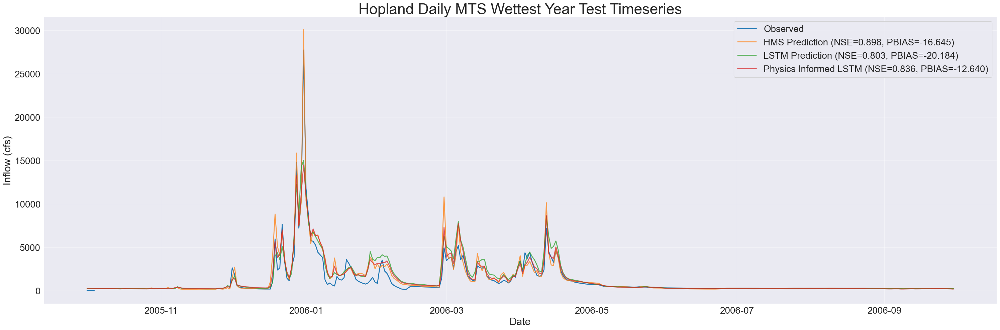

In [42]:
switch_ctx(RES_1D)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Wettest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1D.csv", ts_out="hopland_mts_wet_test_1D_combined_ts.csv", fig_out="hopland_mts_wet_test_1D_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Daily MTS Wettest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1D.csv", ts_out="hopland_mts_wet_test_1D_combined_ts.csv", fig_out="hopland_mts_wet_test_1D_model_comparison.png", legend_font=20, axis_font=22)

In [43]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Wettest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1D.csv", ts_out="hopland_mts_wet_test_1D_combined_ts.csv", fig_out="hopland_mts_wet_test_1D_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Daily MTS Wettest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1D.csv", ts_out="hopland_mts_wet_test_1D_combined_ts.csv", fig_out="hopland_mts_wet_test_1D_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.898
  PBIAS = -16.645
LSTM
  NSE = 0.803
  PBIAS = -20.184
PILSTM
  NSE = 0.836
  PBIAS = -12.640


HMS
  NSE = 0.865
  PBIAS = -16.646
LSTM
  NSE = 0.818
  PBIAS = -11.395
PILSTM
  NSE = 0.822
  PBIAS = -11.553


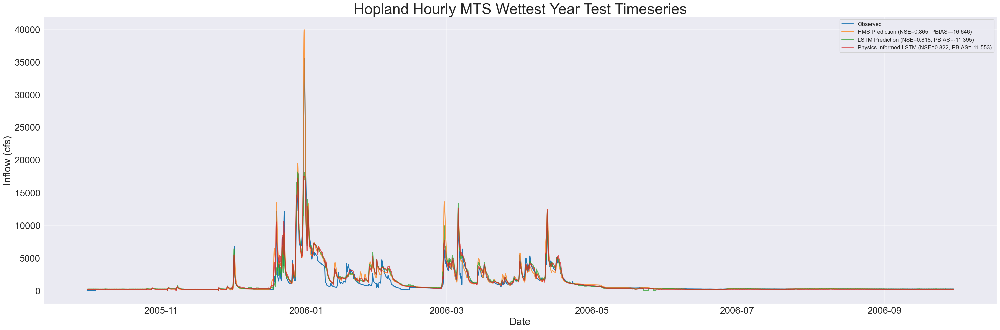

In [44]:
switch_ctx(RES_1H)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), title="Hopland Hourly MTS Wettest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1H.csv", ts_out="hopland_mts_wet_test_1H_combined_ts.csv", fig_out="hopland_mts_wet_test_1H_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1H, title="Hopland Hourly MTS Wettest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1H.csv", ts_out="hopland_mts_wet_test_1H_combined_ts.csv", fig_out="hopland_mts_wet_test_1H_model_comparison.png", legend_font=12, axis_font=22)

In [45]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), title="Hopland Hourly MTS Wettest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1H.csv", ts_out="hopland_mts_wet_test_1H_combined_ts.csv", fig_out="hopland_mts_wet_test_1H_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1H, title="Hopland Hourly MTS Wettest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="hopland_mts_wet_test_metrics_1H.csv", ts_out="hopland_mts_wet_test_1H_combined_ts.csv", fig_out="hopland_mts_wet_test_1H_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.865
  PBIAS = -16.646
LSTM
  NSE = 0.818
  PBIAS = -11.395
PILSTM
  NSE = 0.822
  PBIAS = -11.553


##### Dryest Year Performance

HMS
  NSE = 0.407
  PBIAS = -20.973
LSTM
  NSE = 0.802
  PBIAS = -10.671
PILSTM
  NSE = 0.841
  PBIAS = -10.219


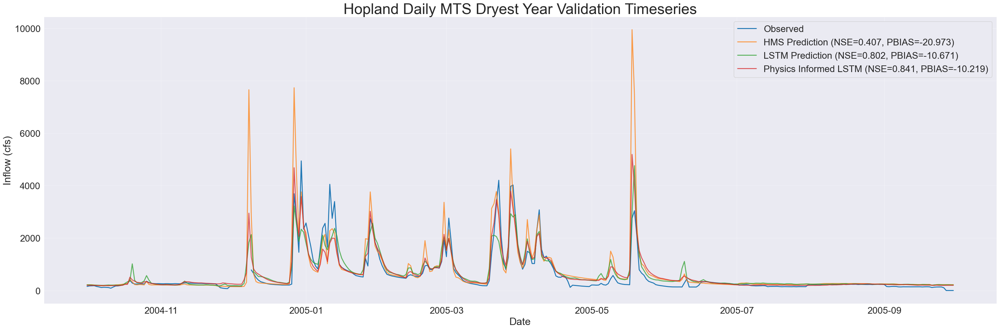

In [46]:
switch_ctx(RES_1D)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1D, phys_val_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Dryest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_val, end_date=dryest_end_val, metrics_out="hopland_mts_dry_val_metrics_1D.csv", ts_out="hopland_mts_dry_val_1D_combined_ts.csv", fig_out="hopland_mts_dry_val_1D_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_daily_val, title="Hopland Daily MTS Dryest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_val, end_date=dryest_end_val, metrics_out="hopland_mts_dry_val_metrics_1D.csv", ts_out="hopland_mts_dry_val_1D_combined_ts.csv", fig_out="hopland_mts_dry_val_1D_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.323
  PBIAS = -20.598
LSTM
  NSE = 0.793
  PBIAS = -8.728
PILSTM
  NSE = 0.729
  PBIAS = -13.567


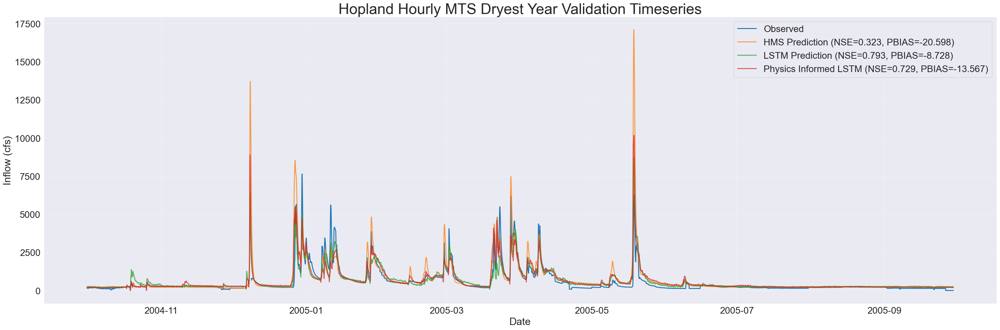

In [47]:
switch_ctx(RES_1H)

if not skip_best_model_validation:
    plot_timeseries_comparison(source=(noPhys_val_csv_1H, phys_val_csv_1H, path_to_physics_data_1H), title="Hopland Hourly MTS Dryest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_val, end_date=dryest_end_val, metrics_out="hopland_mts_dry_val_metrics_1H.csv", ts_out="hopland_mts_dry_val_1H_combined_ts.csv", fig_out="hopland_mts_dry_val_1H_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_hourly_val, title="Hopland Hourly MTS Dryest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_val, end_date=dryest_end_val, metrics_out="hopland_mts_dry_val_metrics_1H.csv", ts_out="hopland_mts_dry_val_1H_combined_ts.csv", fig_out="hopland_mts_dry_val_1H_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.172
  PBIAS = -31.393
LSTM
  NSE = 0.381
  PBIAS = -48.376
PILSTM
  NSE = 0.754
  PBIAS = -37.727


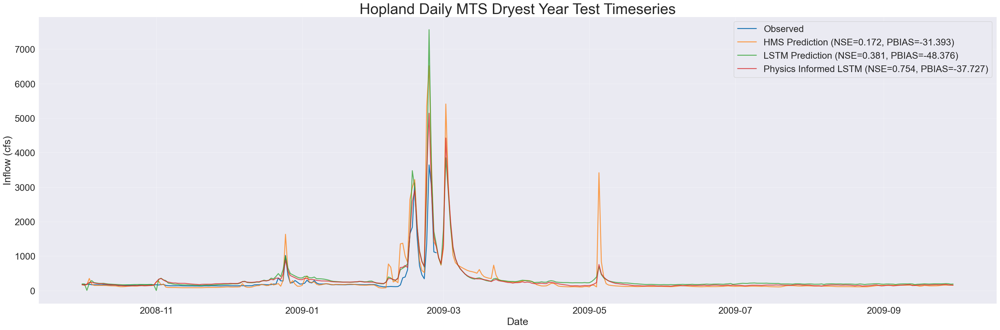

In [48]:
switch_ctx(RES_1D)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Dryest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1D.csv", ts_out="hopland_mts_dry_test_1D_combined_ts.csv", fig_out="hopland_mts_dry_test_1D_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Daily MTS Dryest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1D.csv", ts_out="hopland_mts_dry_test_1D_combined_ts.csv", fig_out="hopland_mts_dry_test_1D_model_comparison.png", legend_font=20, axis_font=22)

In [49]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), title="Hopland Daily MTS Dryest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1D.csv", ts_out="hopland_mts_dry_test_1D_combined_ts.csv", fig_out="hopland_mts_dry_test_1D_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1D, title="Hopland Daily MTS Dryest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1D.csv", ts_out="hopland_mts_dry_test_1D_combined_ts.csv", fig_out="hopland_mts_dry_test_1D_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.172
  PBIAS = -31.393
LSTM
  NSE = 0.381
  PBIAS = -48.376
PILSTM
  NSE = 0.754
  PBIAS = -37.727


HMS
  NSE = 0.022
  PBIAS = -31.536
LSTM
  NSE = 0.151
  PBIAS = -68.340
PILSTM
  NSE = 0.636
  PBIAS = -43.543


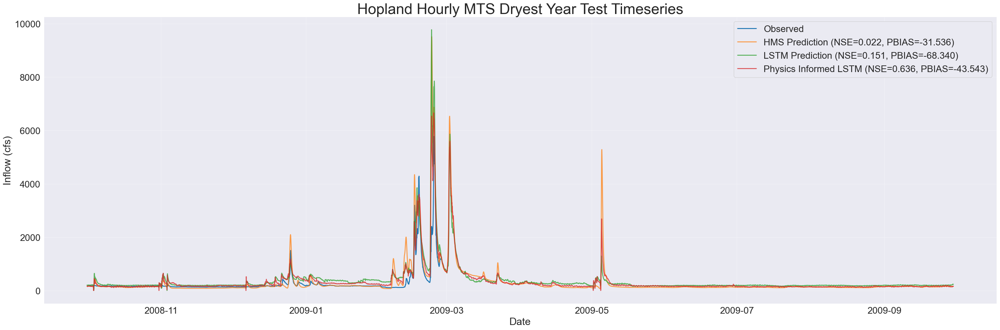

In [50]:
switch_ctx(RES_1H)

if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), title="Hopland Hourly MTS Dryest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1H.csv", ts_out="hopland_mts_dry_test_1H_combined_ts.csv", fig_out="hopland_mts_dry_test_1H_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1H, title="Hopland Hourly MTS Dryest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1H.csv", ts_out="hopland_mts_dry_test_1H_combined_ts.csv", fig_out="hopland_mts_dry_test_1H_model_comparison.png", legend_font=20, axis_font=22)

In [51]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), title="Hopland Hourly MTS Dryest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1H.csv", ts_out="hopland_mts_dry_test_1H_combined_ts.csv", fig_out="hopland_mts_dry_test_1H_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_test_1H, title="Hopland Hourly MTS Dryest Year Test Timeseries - Interactive", backend="plotly", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="hopland_mts_dry_test_metrics_1H.csv", ts_out="hopland_mts_dry_test_1H_combined_ts.csv", fig_out="hopland_mts_dry_test_1H_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.022
  PBIAS = -31.536
LSTM
  NSE = 0.151
  PBIAS = -68.340
PILSTM
  NSE = 0.636
  PBIAS = -43.543


##### Gridded Timeseries Plots - Validation & Testing

In [52]:
switch_ctx(RES_1D)

if not skip_best_model_validation:
    ts_triptych_v3((noPhys_val_csv_1D, phys_val_csv_1D, path_to_physics_data_1D),wet_start=wettest_start_val, wet_end=wettest_end_val, dry_start=dryest_start_val, dry_end=dryest_end_val, save_path="hopland_mts_daily_TS_validation.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d-%b-%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title="Hopland MTS Daily Validation Period Timeseries Across Models", main_title_font=14, main_title_y=0.99, main_title_pad=0.05, row_titles=("Full Validation period","Most-wet water-year","Most-dry water-year"))
    
else:
    ts_triptych_v3(combined_df_daily_val, wet_start=wettest_start_val , wet_end=wettest_end_val, dry_start=dryest_start_val,dry_end=dryest_end_val, save_path="hopland_mts_daily_TS_validation.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d‑%b‑%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title = "Hopland MTS Daily Validation Timeseries Across Models", main_title_font=14, main_title_y = 0.99, main_title_pad = 0.05, row_titles=("Full Validation Period", "Most‑wet water‑year", "Most‑dry water‑year"))

/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/hopland/../../../../UCB-USACE-LSTMs/UCB_training/UCB_plotting.py:363: UserWarning:

Glyph 8209 (\N{NON-BREAKING HYPHEN}) missing from font(s) Arial.



In [53]:
switch_ctx(RES_1H)

if not skip_best_model_validation:
    ts_triptych_v3((noPhys_val_csv_1H, phys_val_csv_1H, path_to_physics_data_1H), wet_start=wettest_start_val, wet_end=wettest_end_val, dry_start=dryest_start_val, dry_end=dryest_end_val, save_path="hopland_mts_hourly_TS_validation.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d-%b-%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title="Hopland MTS Hourly Validation Period Timeseries Across Models", main_title_font=14, main_title_y=0.99, main_title_pad=0.05, row_titles=("Full Validation period","Most-wet water-year","Most-dry water-year"))
    
else:
    ts_triptych_v3(combined_df_hourly_val, wet_start=wettest_start_val, wet_end=wettest_end_val, dry_start=dryest_start_val, dry_end=dryest_end_val, save_path="hopland_mts_hourly_TS_validation.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d‑%b‑%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title = "Hopland MTS Hourly Validation Timeseries Across Models", main_title_font=14, main_title_y = 0.99, main_title_pad = 0.05, row_titles=("Full Validation Period", "Most‑wet water‑year", "Most‑dry water‑year"))

/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/hopland/../../../../UCB-USACE-LSTMs/UCB_training/UCB_plotting.py:363: UserWarning:

Glyph 8209 (\N{NON-BREAKING HYPHEN}) missing from font(s) Arial.



In [54]:
switch_ctx(RES_1D)

if not skip_best_model_test:
    ts_triptych_v3((no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), wet_start=wettest_start_test, wet_end=wettest_end_test, dry_start=dryest_start_test, dry_end=dryest_end_test, save_path="hopland_mts_daily_TS_test.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d-%b-%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title="Hopland MTS Daily Test Period Timeseries Across Models", main_title_font=14, main_title_y=0.99, main_title_pad=0.05, row_titles=("Full Test period","Most-wet water-year","Most-dry water-year"))
    
else:
    ts_triptych_v3(combined_df_daily, wet_start=wettest_start_test, wet_end=wettest_end_test, dry_start=dryest_start_test, dry_end=dryest_end_test, save_path="hopland_mts_daily_TS_test.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d‑%b‑%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title = "Hopland MTS Daily Test Timeseries Across Models", main_title_font=14, main_title_y = 0.99, main_title_pad = 0.05, row_titles=("Full Test Period", "Most‑wet water‑year", "Most‑dry water‑year"))

/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/hopland/../../../../UCB-USACE-LSTMs/UCB_training/UCB_plotting.py:363: UserWarning:

Glyph 8209 (\N{NON-BREAKING HYPHEN}) missing from font(s) Arial.



In [55]:
switch_ctx(RES_1H)

if not skip_best_model_test:
    ts_triptych_v3((no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), wet_start=wettest_start_test, wet_end=wettest_end_test, dry_start=dryest_start_test, dry_end=dryest_end_test, save_path="hopland_mts_hourly_TS_test.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d-%b-%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title="Hopland MTS Hourly Test Period Timeseries Across Models", main_title_font=14, main_title_y=0.99, main_title_pad=0.05, row_titles=("Full Test period","Most-wet water-year","Most-dry water-year"))
    
else:
    ts_triptych_v3(combined_df_hourly, wet_start=wettest_start_test, wet_end=wettest_end_test, dry_start=dryest_start_test, dry_end=dryest_end_test, save_path="hopland_mts_hourly_TS_test.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d‑%b‑%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title = "Hopland MTS Hourly Test Timeseries Across Models", main_title_font=14, main_title_y = 0.99, main_title_pad = 0.05, row_titles=("Full Test Period", "Most‑wet water‑year","Most‑dry water‑year"))

/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/hopland/../../../../UCB-USACE-LSTMs/UCB_training/UCB_plotting.py:363: UserWarning:

Glyph 8209 (\N{NON-BREAKING HYPHEN}) missing from font(s) Arial.



##### Gridded Scatter Plots - Test

In [56]:
switch_ctx(RES_1D)

if not skip_best_model_test:
    scatter_pngs = scatter_triptych_pngs_v3((no_physics_test_csv_1D, physics_test_csv_1D, path_to_physics_data_1D), wet_start = wettest_start_test, wet_end = wettest_end_test, dry_start = dryest_start_test, dry_end = dryest_end_test, out_dir = "hopland_mts_daily_scatter", layout = "horizontal", square_side = 4.5, legend_font  = 16, axis_font = 16, point_size = 28, top_pad = .90, suptitle_y = 1.04, dpi = 600, row_titles = ("Hopland MTS Daily – Full test period", "Hopland MTS Daily – Wettest water‑year", "Hopland MTS Daily – Driest water‑year"), resolution="mts_daily")

else:
    scatter_pngs = scatter_triptych_pngs_v3(combined_df_daily, wet_start = wettest_start_test, wet_end = wettest_end_test, dry_start = dryest_start_test, dry_end = dryest_end_test, out_dir = "hopland_mts_daily_scatter", layout = "horizontal", square_side = 4.5,legend_font  = 16, axis_font = 16, point_size = 28, top_pad = .90, suptitle_y = 1.04, dpi = 600, row_titles = ("Hopland MTS Daily – Full test period", "Hopland MTS Daily – Wettest water‑year", "Hopland MTS Daily – Driest water‑year"), resolution="mts_daily")

In [57]:
switch_ctx(RES_1H)

if not skip_best_model_test:
    scatter_pngs = scatter_triptych_pngs_v3((no_physics_test_csv_1H, physics_test_csv_1H, path_to_physics_data_1H), wet_start = wettest_start_test, wet_end = wettest_end_test, dry_start = dryest_start_test, dry_end = dryest_end_test, out_dir = "hopland_mts_hourly_scatter", layout = "horizontal", square_side = 4.5, legend_font = 16, axis_font = 16, point_size = 28, top_pad = .90, suptitle_y = 1.04, dpi = 600, row_titles = ("Hopland MTS Hourly – Full test period", "Hopland MTS Hourly – Wettest water‑year", "Hopland MTS Hourly – Driest water‑year"), resolution="mts_hourly")
    
else:
    scatter_pngs = scatter_triptych_pngs_v3(combined_df_hourly, wet_start = wettest_start_test, wet_end = wettest_end_test, dry_start = dryest_start_test,  dry_end = dryest_end_test, out_dir = "hopland_mts_hourly_scatter", layout = "horizontal", square_side = 4.5, legend_font = 16, axis_font = 16, point_size = 28, top_pad = .90, suptitle_y = 1.04, dpi = 600, row_titles = ("Hopland MTS Hourly – Full test period", "Hopland MTS Hourly – Wettest water‑year", "Hopland MTS Hourly – Driest water‑year"),resolution="mts_hourly")